# Experiments to extract background

In [2]:
import roman_datamodels as rdm
from roman_datamodels.dqflags import pixel
import matplotlib.pyplot as plt
from astropy import visualization
import numpy as np

In [3]:
infile = '/Users/dfadda/Roman/ScienceValidation/Simulations/r4444401001001001001_0002_wfi11_f106_cal.asdf'
with rdm.open(infile) as dm:
        data = dm.data.copy()
        err = dm.err.copy()
        wcs = dm.meta.wcs
        dq = dm.dq.copy()

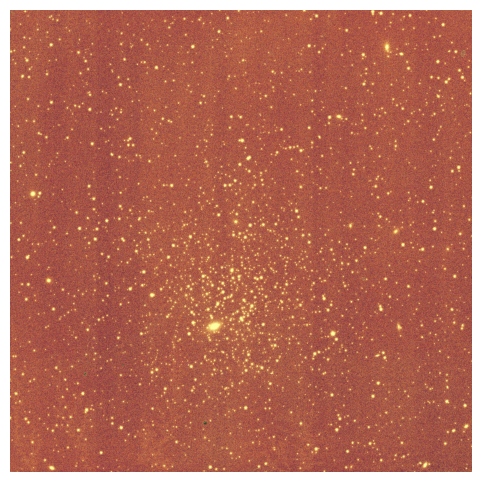

In [23]:
norm = visualization.ImageNormalize(data,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(6,6))
plot = ax.imshow(data, norm=norm, origin='lower',cmap='inferno')
ax.axis('off')
plt.show()

In [46]:
import numpy as np
nblock = 7*2
print(nblock*0.11)
n = 2**17
print(np.sqrt(np.pi/3)/n * 180/np.pi * 3600)
n = 2**11
print(np.sqrt(np.pi/3)/n * 180/np.pi * 60)

1.54
1.610384255539409
1.717743205908703


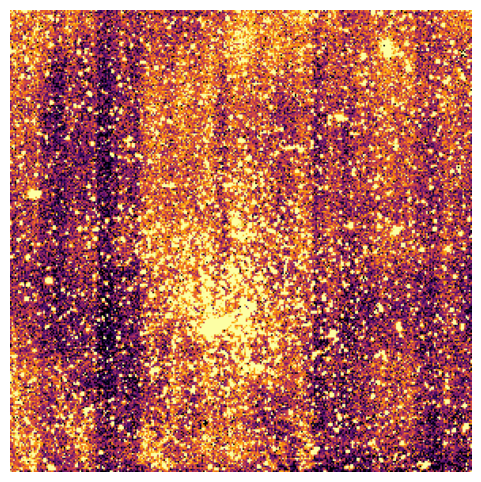

In [39]:
nblock = 7*2
databinned = block_reduce(data, nblock, func=np.nanmean)

norm = visualization.ImageNormalize(databinned,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(6,6))
plot = ax.imshow(databinned, norm=norm, origin='lower',cmap='inferno')
ax.axis('off')
plt.show()

In [19]:
from wfiskymatch.tools import maskSources
mask = maskSources(data, dq=dq)

In [47]:
from astropy.nddata import block_reduce
import numpy as np

data1 = data.copy()
data1[mask]=np.nan
nblock = 7*2
datamasked = block_reduce(data1, nblock, func=np.nanmean)

from maskfill import maskfill
idx = ~np.isfinite(datamasked)
if np.sum(idx) > 0:
    mask1 = np.zeros(np.shape(datamasked))
    mask1[idx] = 1
    datafilled,_ = maskfill(datamasked, mask1, operator='median' )
else:
    datafilled = data1

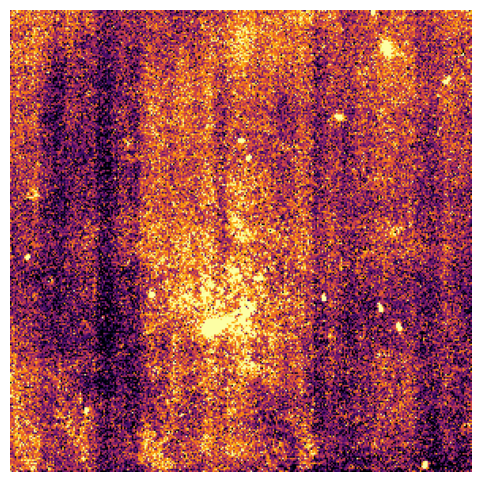

In [48]:
#norm = visualization.ImageNormalize(datafilled,
#                                    interval=visualization.ZScaleInterval(contrast=1),
#                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(6,6))
plot = ax.imshow(datafilled, norm=norm, origin='lower',cmap='inferno')
ax.axis('off')
plt.show()

In [1]:
from wfiskymatch.tools import asdf2healpix
infile = '/Users/dfadda/Roman/ScienceValidation/Simulations/r4444401001001001001_0002_wfi11_f106_cal.asdf'
asdf2healpix(infile,'/Users/dfadda/Roman/BgrMatch/Comparison/tmp/')

file  r4444401001001001001_0002_wfi11_f106_cal  read in  0.7534980773925781


/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/astropy/nddata/blocks.py:160: RuntimeWarning: Mean of empty slice
  return func(reshaped, axis=axis)


saving in /Users/dfadda/Roman/BgrMatch/Comparison/tmp/r4444401001001001001_0002_wfi11_f106_cal.h5 time:  9.890379905700684


# Test with 2MASS image

In [33]:
import tarfile, os, gzip
from astropy.io import fits

outdir = '/Users/dfadda/Roman/BgrMatch/Comparison/'
object = 'M31'
n = 0
with tarfile.open(os.path.join(outdir,object+'.tar')) as tar:
    for item in tar.getnames():
            if item.endswith('fits.gz'):
                if n == 25:
                    print(item)
                    tar.extract(item, '.',filter='data', numeric_owner=True)
                    with fits.open(item) as f:
                        data = f[0].data
                    os.remove(item)
                n += 1

Users/dfadda/Roman/BgrMatch/Comparison/M31_120.fits.gz


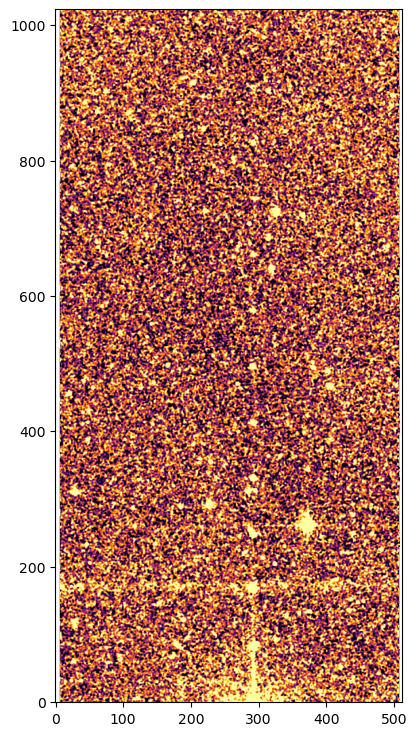

In [34]:
norm = visualization.ImageNormalize(data,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(data, norm=norm, origin='lower',cmap='inferno')

In [41]:
from wfiskymatch.tools import maskSources
mask = maskSources(data, fwhm=3, areathreshold=200)

In [42]:
import numpy as np

data1 = data.copy()
data1[mask]=np.nan
from maskfill import maskfill
idx = ~np.isfinite(data1)
if np.sum(idx) > 0:
    mask1 = np.zeros(np.shape(data1))
    mask1[idx] = 1
    datafilled,_ = maskfill(data1, mask1, operator='median' )
else:
    datafilled = data1

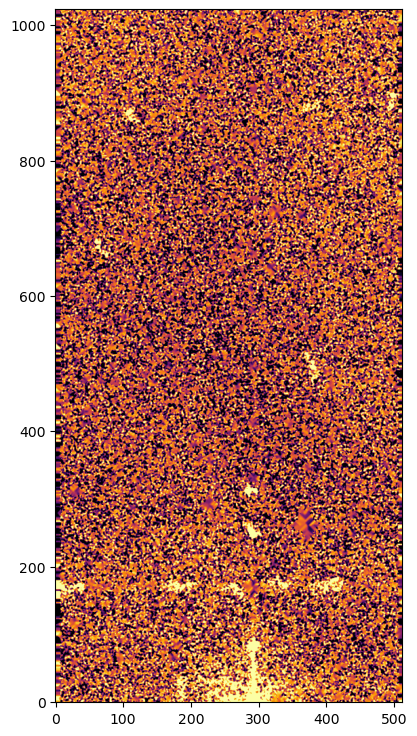

In [43]:
norm = visualization.ImageNormalize(datafilled,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(datafilled, norm=norm, origin='lower',cmap='inferno')

# Segmentation file with photutils

In [4]:
from photutils.background import Background2D, MedianBackground

bkg_estimator = MedianBackground()
bkg = Background2D(data0, (50, 50), filter_size=(3, 3), bkg_estimator=bkg_estimator)
data = data0 - bkg.background  # subtract the background

In [5]:
from astropy.convolution import convolve
from photutils.segmentation import make_2dgaussian_kernel

kernel = make_2dgaussian_kernel(1.0, size=5)  # FWHM = 3.0
convolved_data = convolve(data, kernel)

In [23]:
from photutils.segmentation import detect_sources
threshold = 0.7 * bkg.background_rms
segment_map = detect_sources(convolved_data, threshold, npixels=10)

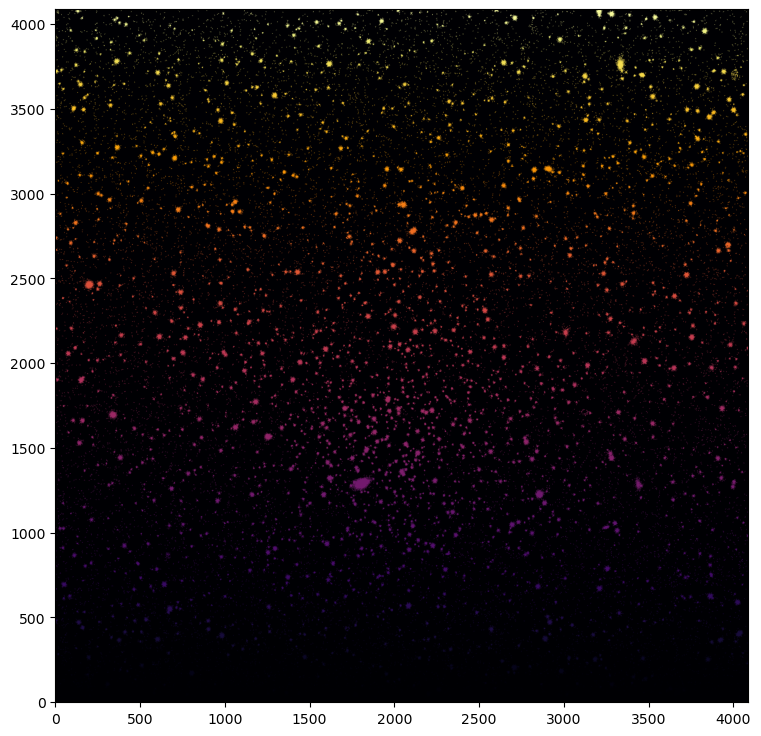

In [24]:
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(segment_map, origin='lower',cmap='inferno')

In [25]:
from photutils.segmentation import SourceCatalog
cat = SourceCatalog(data, segment_map, convolved_data=convolved_data)

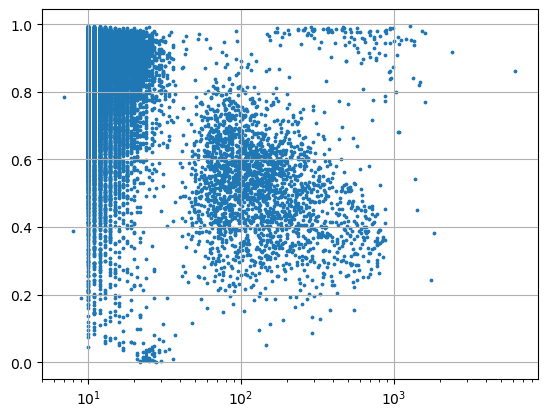

In [51]:
plt.scatter(cat.area.value,cat.eccentricity.value, s=3)
plt.xscale('log')
plt.grid()

In [52]:
ecc = (cat.eccentricity.value < 0.8) | (cat.area.value < 1000)
roundsources = cat.label[ecc]
print(roundsources)

[    1     2     3 ... 19479 19480 19481]


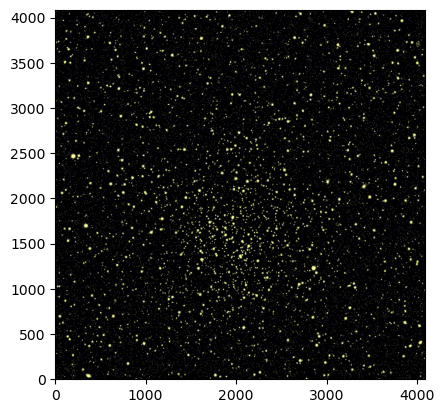

In [53]:
mask = np.isin(segment_map.data, roundsources)
plt.imshow(mask,cmap='inferno',origin='lower')

# Impainting

In [232]:
datamasked = data0.copy()
mask = np.isin(segment_map.data, roundsources)
#datamasked[mask] = np.nan
idx = dq == pixel.GOOD.value
mask[~idx] = True
datamasked[mask] = np.nan
#mask = (dq & ~pixel.GOOD.value)
#mask = (dq & pixel.DO_NOT_USE.value) 
#mask |= (dq & pixel.DEAD) 
#mask |= (dq & pixel.SATURATED)
#mask |=  (dq & pixel.JUMP_DET) 
#mask |= (dq & pixel.NON_SCIENCE) 
#mask |= (dq & pixel.HOT)
#mask |= (dq & pixel.DROPOUT)
#mask |= (dq & pixel.NONLINEAR)
#mask |= (dq & pixel.LOW_QE)
#datamasked[mask > 0] = np.nan

In [233]:
from maskfill import maskfill
idx = datamasked == np.nan
mask = np.zeros(np.shape(datamasked))
mask[idx] = 1
datafilled,_ = maskfill(datamasked, mask, operator='mean')

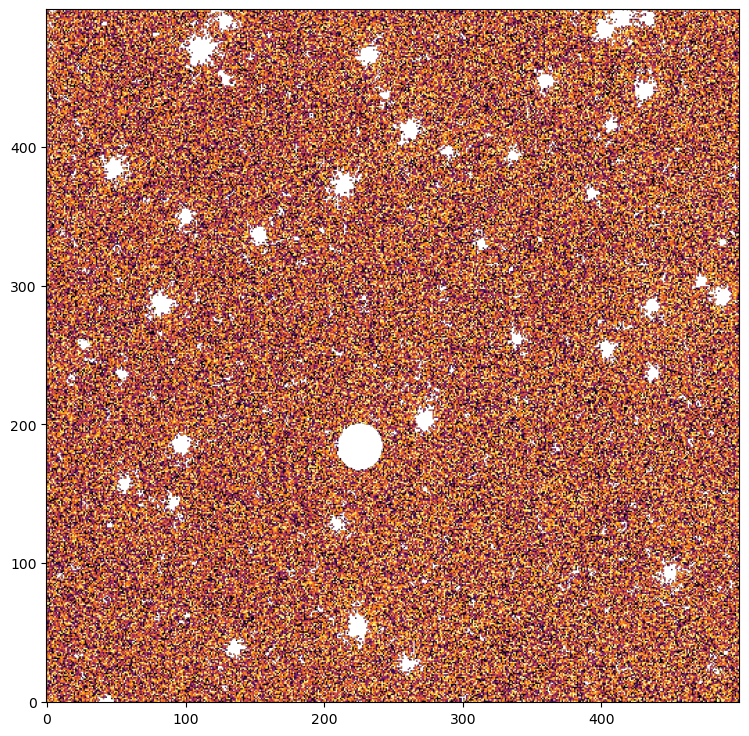

In [234]:
norm = visualization.ImageNormalize(datamasked,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(datamasked[250:750,1500:2000], norm=norm, origin='lower',cmap='inferno')

flag      :  0b10000100010010000000000000
unr slope:   0b1000000000000000000000000
unr flat :   0b10000000000000000000000000
do not use:  0b1
persistence: 0b100000
ref pixel:   0b10000000000000000000000000000000
low QE.  :   0b10000000000000
outlier  :   0b10000000
flag      :  0b0
flag      :  0b10000000000000
flag      :  0b100000010000000000000
flag      :  0b100010010000000000000
flag      :  0b100010010000000000001
flag      :  0b10000000010010000000000011
flag      :  0b10000100010010000000000000
flag      :  0b10000100010010000000000001


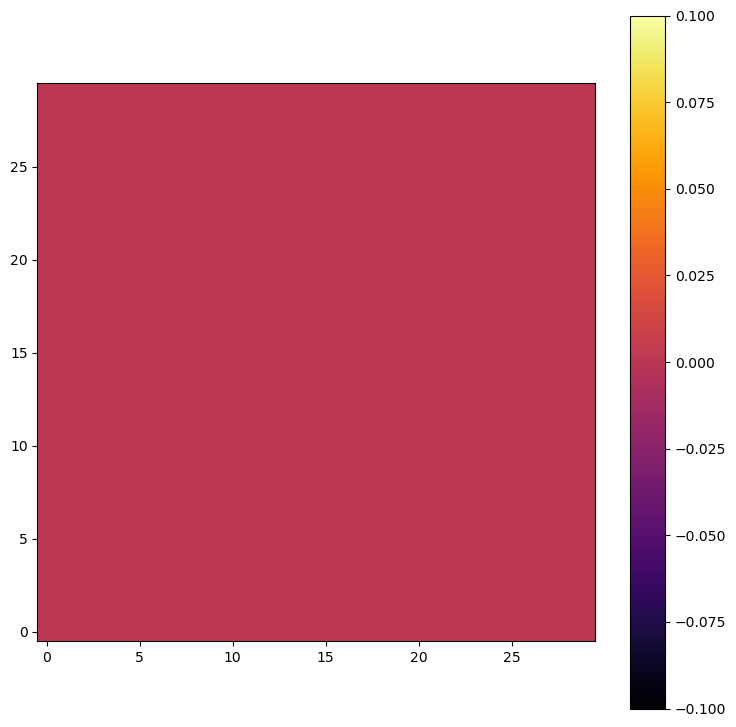

In [155]:
fig, ax = plt.subplots(figsize=(9, 9))
#plot = ax.imshow((dq & pixel.LOW_QE)[420:450,1710:1740], origin='lower',cmap='inferno')
plot = ax.imshow(mask[420:450,1710:1740], origin='lower',cmap='inferno')
fig.colorbar(plot)
flag = int(np.median(dq[420:450,1710:1740]))
print('flag      : ',bin(flag))
print('unr slope:  ', bin(pixel.UNRELIABLE_SLOPE.value))
print('unr flat :  ', bin(pixel.UNRELIABLE_FLAT.value))
print('do not use: ', bin(pixel.DO_NOT_USE.value))
print('persistence:', bin(pixel.PERSISTENCE.value))
print('ref pixel:  ', bin(pixel.REFERENCE_PIXEL.value))
print('low QE.  :  ', bin(pixel.LOW_QE.value))
print('outlier  :  ', bin(pixel.OUTLIER.value))
values = dq[420:450,1710:1740]
flags = np.unique(values)
for flag in flags:
    print('flag      : ',bin(int(flag)))

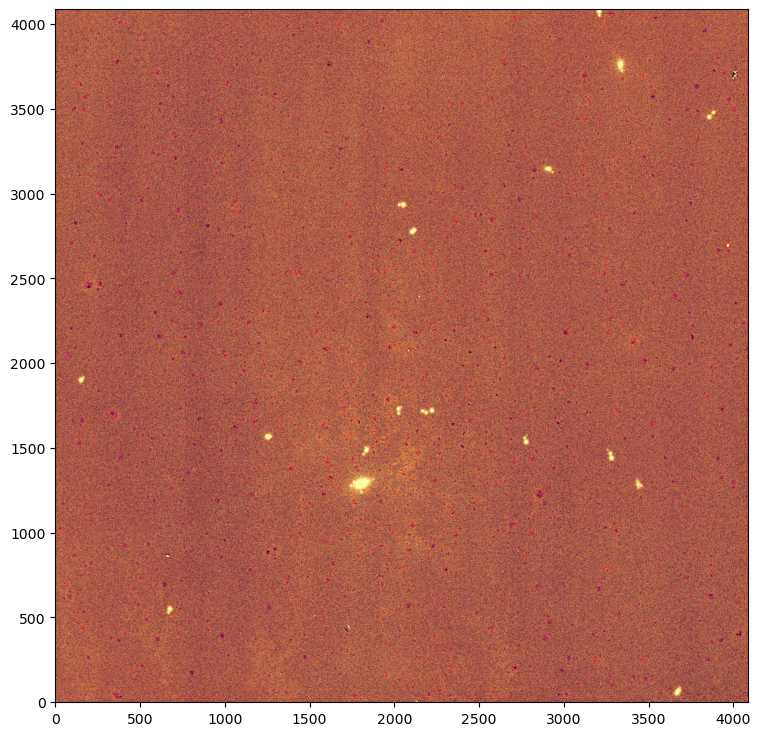

In [235]:
#norm = visualization.ImageNormalize(datafilled,
#                                    interval=visualization.ZScaleInterval(contrast=1),
#                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(datafilled, norm=norm, origin='lower',cmap='inferno')

# Vertical striping ?

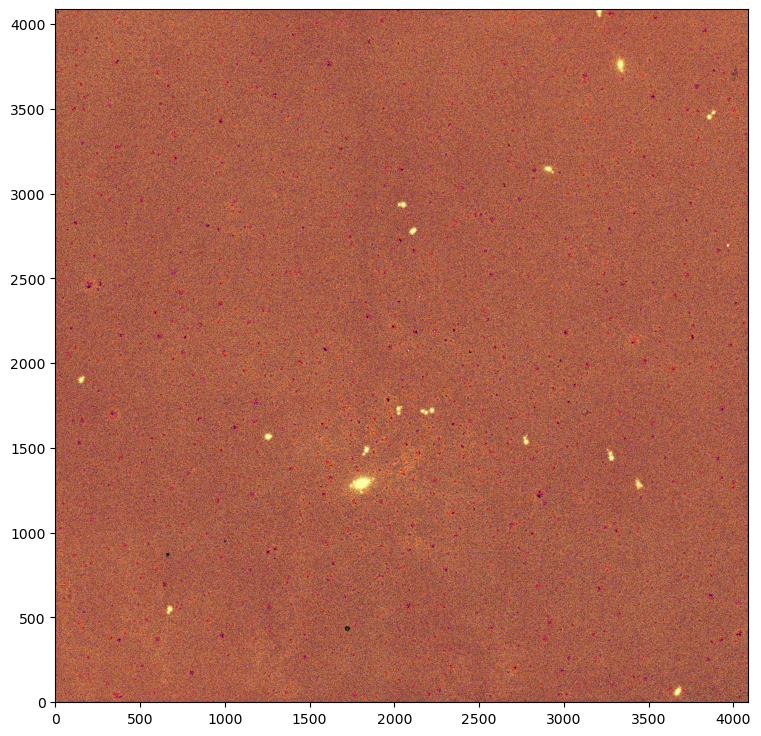

In [58]:
datadestriped = datafilled.copy()
datamedcol = np.median(datadestriped, axis=0)
medimage = np.nanmedian(datamedcol)
for i, m in enumerate(datamedcol):
    datadestriped[:,i] -= m

datadestriped += medimage
norm = visualization.ImageNormalize(datafilled,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(datadestriped, norm=norm, origin='lower',cmap='inferno')

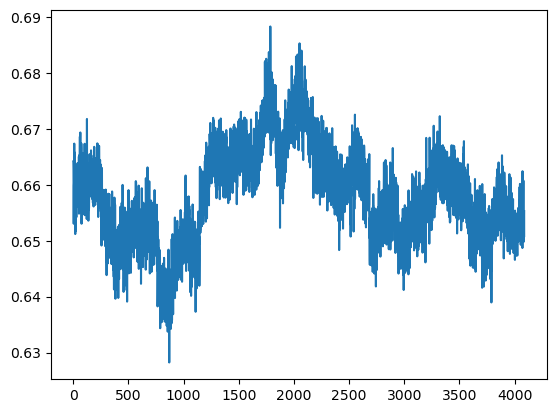

In [59]:
plt.plot(datamedcol)

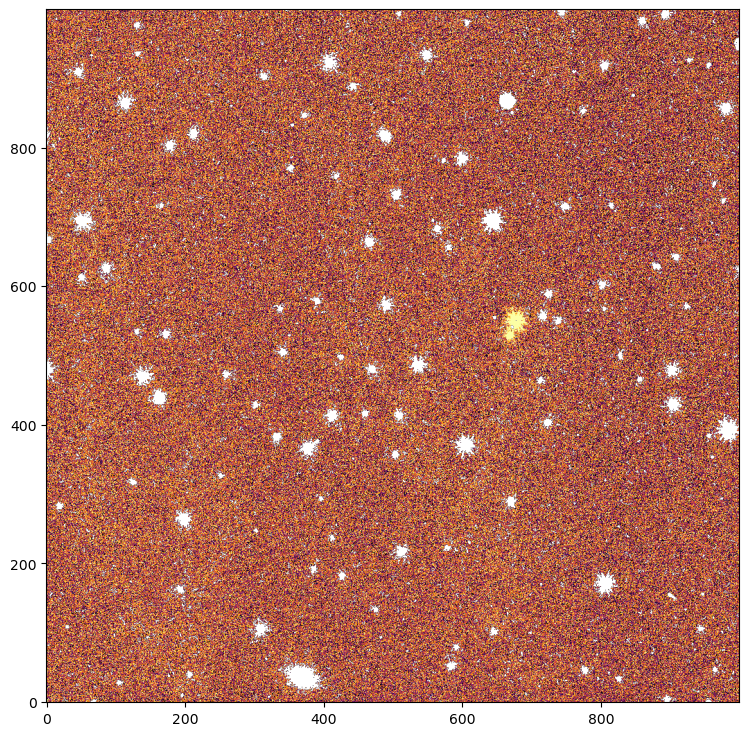

In [176]:
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(datamasked[0:1000,0:1000], norm=norm, origin='lower',cmap='inferno')

# Reduce

In [236]:
from astropy.nddata import block_reduce
nblock = 7
data1 = block_reduce(datafilled, nblock, func=np.nanmean)

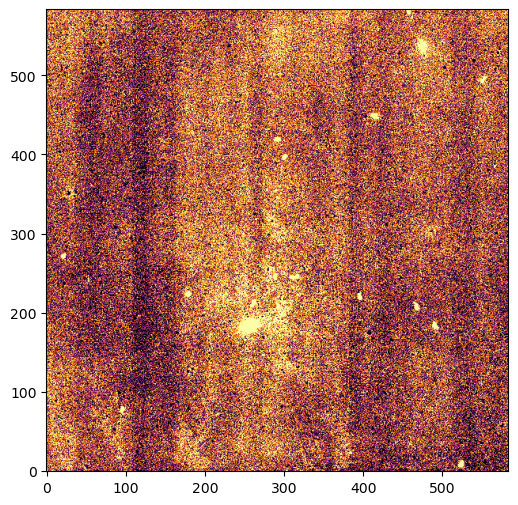

In [242]:
fig, ax = plt.subplots(figsize=(6,6))
norm = visualization.ImageNormalize(data1,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
plot = ax.imshow(data1, norm=norm, origin='lower',cmap='inferno')

In [238]:
from astropy.nddata import block_reduce
# mask bad pixels (substitute with median filtered image)
#mask = (dq & pixel.DO_NOT_USE.value) | (dq & pixel.DEAD) | (dq & pixel.SATURATED)| (dq & pixel.JUMP_DET) 
#data[mask == 1] = np.nan
nblock = 7
data2 = block_reduce(data0, nblock, func=np.nanmean)

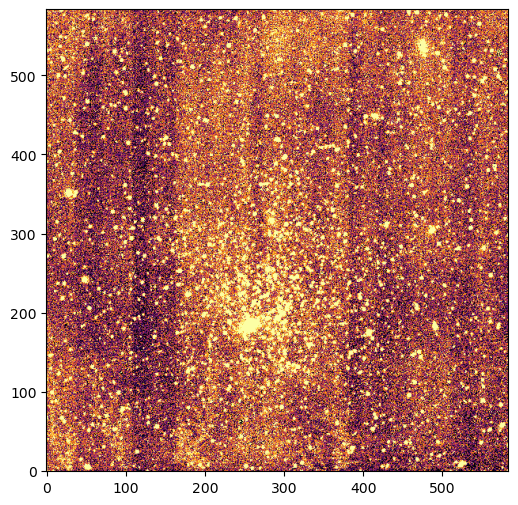

In [239]:
norm = visualization.ImageNormalize(data2,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(6,6))
plot = ax.imshow(data2, norm=norm, origin='lower',cmap='inferno')

In [240]:
data3 = block_reduce(datamasked, nblock, func=np.nanmean)
from maskfill import maskfill
idx = ~np.isfinite(data3)
if np.sum(idx) > 0:
    mask = np.zeros(np.shape(data3))
    mask[idx] = 1
    data3f,_ = maskfill(data3, mask, operator='median' )
else:
    data3f = data3

/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/astropy/nddata/blocks.py:160: RuntimeWarning: Mean of empty slice
  return func(reshaped, axis=axis)


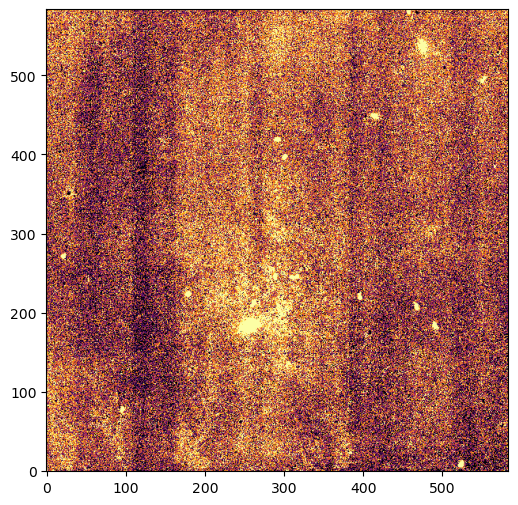

In [241]:
norm = visualization.ImageNormalize(data3f,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(6,6))
plot = ax.imshow(data3f, norm=norm, origin='lower',cmap='inferno')

# Other possible methods

In [42]:
from skimage.morphology import erosion
from skimage.morphology import footprint_rectangle

eroded = erosion(data, footprint_rectangle((21,21)))

removed = data - eroded

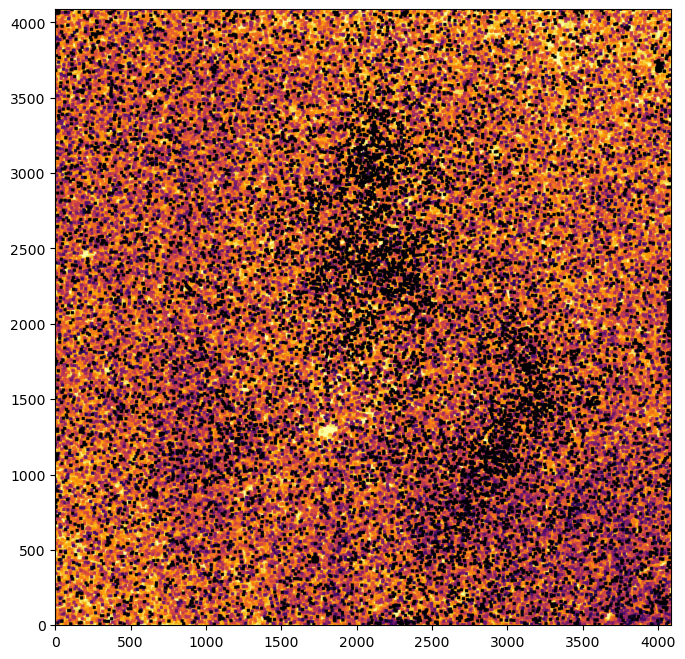

In [14]:
norm = visualization.ImageNormalize(eroded,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(8,8))


plot = ax.imshow(eroded, norm=norm, origin='lower',cmap='inferno')

In [15]:
from astropy.nddata import block_reduce
# mask bad pixels (substitute with median filtered image)
nblock = 14
data3 = block_reduce(eroded, nblock, func=np.nanmedian)

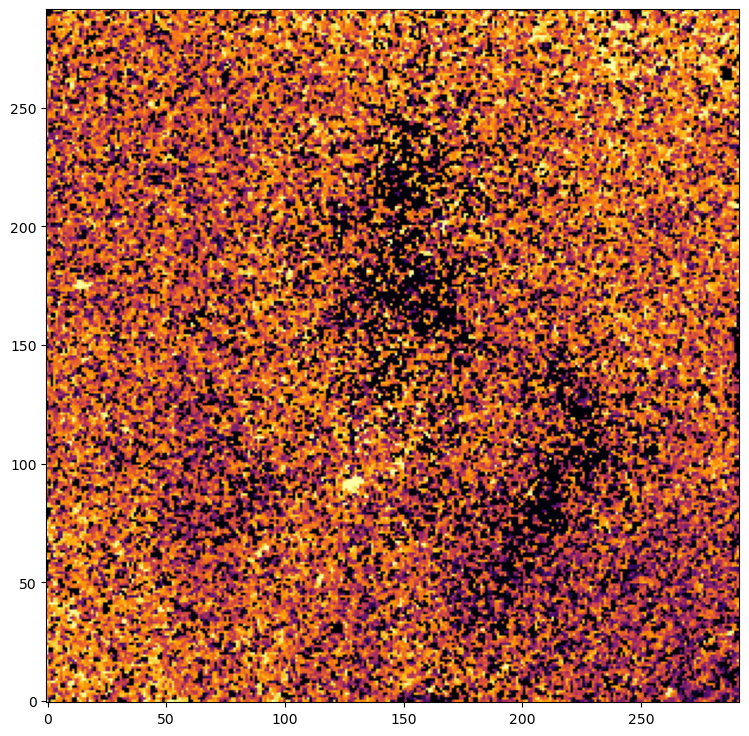

In [16]:
norm = visualization.ImageNormalize(data3,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))


plot = ax.imshow(data3, norm=norm, origin='lower',cmap='inferno')

In [24]:
import skimage as ski
#image = ski.filters.rank.median(data, ski.morphology.disk(3))

datam = data/ np.nanmax(data)

image= ski.filters.rank.median(datam, ski.morphology.disk(10))

0.0


In [14]:
from photutils.background import Background2D

coverage_mask = (data == np.nan)
bkg = Background2D(data, (11, 11), filter_size=(3, 3), coverage_mask=coverage_mask, fill_value=0.0, exclude_percentile=50.0)

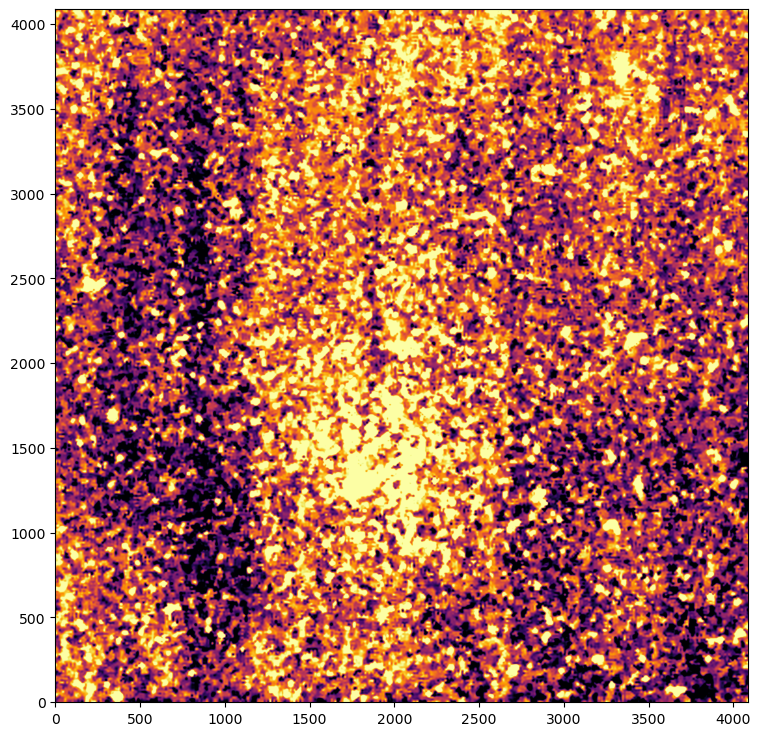

In [15]:
norm = visualization.ImageNormalize(bkg.background,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(bkg.background, norm=norm, origin='lower',cmap='inferno')

# Using RomanCal products

In [10]:
import asdf
path = '/Users/dfadda/Roman/ScienceValidationNew/'
file = 'shift5arcsec_wfi01_f106_segm.asdf'

with asdf.open(path+file) as dm:
    #dm.info()
    rtree = dm.tree['roman']
    meta = rtree['meta']
    segment_map = rtree['data'].copy()

/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/yamlutil.py:355: AsdfConversionWarning: tag:stsci.edu:asdf/time/time-1.3.0 is not recognized, converting to raw Python data structure
  warnings.warn(
/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/yamlutil.py:355: AsdfConversionWarning: asdf://stsci.edu/datamodels/roman/tags/visit-1.2.0 is not recognized, converting to raw Python data structure
  warnings.warn(
/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/yamlutil.py:355: AsdfConversionWarning: asdf://stsci.edu/datamodels/roman/tags/segmentation_map-1.3.0 is not recognized, converting to raw Python data structure
  warnings.warn(
/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/_asdf.py:310: AsdfPackageVersionWarning: File 'file:///Users/dfadda/Roman/ScienceValidationNew/shift5arcsec_wfi01_f106_segm.asdf' was created with extension URI 'asdf://asdf-format.org/core/extensions

In [14]:
from astropy.table import Table
path = '/Users/dfadda/Roman/ScienceValidationNew/'
file = 'shift5arcsec_wfi01_f106_cat.parquet'
t = Table.read(path+file)

In [20]:
t[:5]

label,flagged_spatial_index,x_centroid,y_centroid,x_centroid_err,y_centroid_err,x_centroid_win,y_centroid_win,x_centroid_win_err,y_centroid_win_err,x_psf,x_psf_err,y_psf,y_psf_err,ra,dec,ra_centroid,dec_centroid,ra_centroid_err,dec_centroid_err,ra_centroid_win,dec_centroid_win,ra_centroid_win_err,dec_centroid_win_err,ra_psf,dec_psf,ra_psf_err,dec_psf_err,bbox_xmin,bbox_xmax,bbox_ymin,bbox_ymax,segment_area,semimajor,semiminor,fwhm,ellipticity,orientation_pix,orientation_sky,cxx,cxy,cyy,kron_radius,nn_label,nn_distance,sharpness,roundness1,is_extended,fluxfrac_radius_50,aper_bkg_flux,aper_bkg_flux_err,aper01_flux,aper01_flux_err,aper02_flux,aper02_flux_err,aper04_flux,aper04_flux_err,aper08_flux,aper08_flux_err,aper16_flux,aper16_flux_err,psf_flux,psf_flux_err,segment_flux,segment_flux_err,kron_flux,kron_flux_err,kron_abmag,kron_abmag_err,warning_flags,image_flags,psf_flags,psf_gof
,,pix,pix,pix,pix,pix,pix,pix,pix,pix,pix,pix,pix,deg,deg,deg,deg,arcsec,arcsec,deg,deg,arcsec,arcsec,deg,deg,arcsec,arcsec,,,,,arcsec2,arcsec,arcsec,arcsec,,deg,deg,1 / arcsec2,1 / arcsec2,1 / arcsec2,arcsec,,arcsec,,,,arcsec,nJy / arcsec2,nJy / arcsec2,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,nJy,mag(AB),mag(AB),,,,
int32,int64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64,float64,float64,float32,float32,float64,float64,float32,float32,float64,float64,float32,float32,int32,int32,int32,int32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,int32,float32,float32,float32,bool,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,int32,int32,int32,float32
1,0,850.32855,11.629537,0.0,0.0,850.2148,11.630872,0.0,0.0,850.19336,0.03776525,11.770497,0.03778423,161.19090968073127,57.97463658948204,161.19090968073127,57.97463658948204,0.0,0.0,161.19091624075367,57.97463662697163,0.0,0.0,161.1909174520287,57.974640792784875,0.0,0.0,848,853,9,14,0.3584438,0.15852615,0.14408098,0.3566984,0.091121644,40.34503,130.06071,43.303917,-8.268519,44.659412,0.28573605,5,19.116426,0.8588206,-0.17105114,True,0.37369826,-19.57368,127.217316,804.3221,57.396236,2176.1382,105.053734,4670.0776,184.2587,7895.2505,328.6822,9903.385,630.89496,3530.3586,152.29877,3867.717,159.68854,8626.184,395.74722,21.560455,0.048702005,0,0,1,2.2683
2,0,1768.1499,41.96386,0.0,0.0,1768.0303,42.011147,0.0,0.0,1768.146,0.012908226,42.018955,0.01177885,161.137977833994,57.975568045985696,161.137977833994,57.975568045985696,0.0,0.0,161.13798471781078,57.97556945242876,0.0,0.0,161.13797804040541,57.97556968964624,0.0,0.0,1766,1771,39,45,0.38234004,0.12048851,0.11685415,0.2794824,0.030163541,-85.36395,4.3517356,73.2054,0.7011035,68.9109,0.15303048,3,35.82958,1.115061,-0.023533039,False,0.07272926,-390.744,102.74259,10826.115,156.84538,15915.021,202.37328,17755.58,249.46443,18332.99,362.56616,17914.242,634.66675,19187.783,295.2673,17495.885,236.4867,17819.564,252.41376,20.772758,0.015271465,0,0,1,0.69857067
3,0,1437.6182,57.4555,0.0,0.0,1437.9585,57.79256,0.0,0.0,1437.5125,0.05868913,57.635555,0.07071184,161.1570319911742,57.976019171510146,161.1570319911742,57.976019171510146,0.0,0.0,161.15701228308325,57.97602923966154,0.0,0.0,161.15703804416674,57.976024540962094,0.0,0.0,1435,1440,55,60,0.34649566,0.12557745,0.09600265,0.26320425,0.23551044,38.612682,128.32837,80.97197,-43.972134,90.94173,0.15303048,2,35.82958,-0.4261791,0.1021971,False,0.08688172,-142.87741,104.54463,69417.59,623.9339,103359.7,764.09326,103318.43,783.5335,103079.08,938.8025,102216.46,1226.4424,4917.389,359.749,103321.46,767.897,103317.945,777.7323,18.86456,0.008142369,0,0,1,22.066439
4,0,4063.895,146.44237,0.0,0.0,4063.8203,146.48553,0.0,0.0,4063.9587,0.01796556,146.42487,0.0152054755,161.0056743001008,57.9788170335617,161.0056743001008,57.9788170335617,0.0,0.0,161.00567856595873,57.97881831482745,0.0,

In [35]:
area = t['segment_area'].value/0.11**2 # area in pixels
ellipticity = t['ellipticity'].value
label = t['label'].value
x, y = t['x_centroid'].value, t['y_centroid'].value

In [24]:
import asdf
path = '/Users/dfadda/Roman/ScienceValidationNew/'
file = 'shift5arcsec_wfi01_f106_cal.asdf'

with asdf.open(path+file) as dm:
    #dm.info()
    rtree = dm.tree['roman']
    meta = rtree['meta']
    dq = rtree['dq'].copy()
    data0 = rtree['data'].copy()

/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/yamlutil.py:355: AsdfConversionWarning: asdf://stsci.edu/datamodels/roman/tags/l2_cal_step-1.2.0 is not recognized, converting to raw Python data structure
  warnings.warn(
/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/yamlutil.py:355: AsdfConversionWarning: tag:stsci.edu:asdf/time/time-1.3.0 is not recognized, converting to raw Python data structure
  warnings.warn(
/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/yamlutil.py:355: AsdfConversionWarning: asdf://stsci.edu/datamodels/roman/tags/exposure-1.3.0 is not recognized, converting to raw Python data structure
  warnings.warn(
/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/asdf/yamlutil.py:355: AsdfConversionWarning: asdf://stsci.edu/datamodels/roman/tags/guidestar-1.2.0 is not recognized, converting to raw Python data structure
  warnings.warn(
/Users/dfadda/miniconda3/envs/w

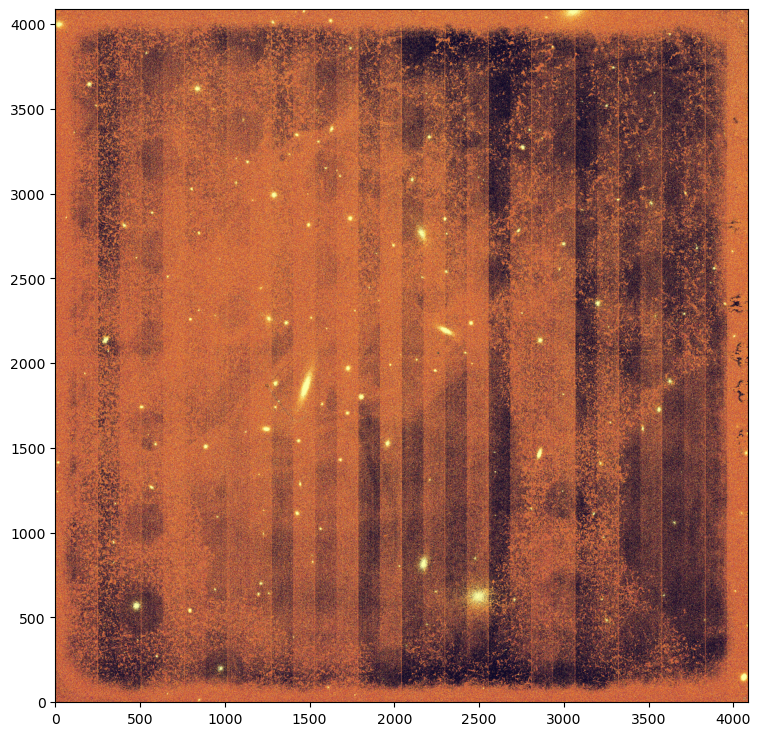

In [4]:
import matplotlib.pyplot as plt
from astropy import visualization
norm = visualization.ImageNormalize(data0,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(data0, norm=norm, origin='lower',cmap='inferno')

## Background extraction

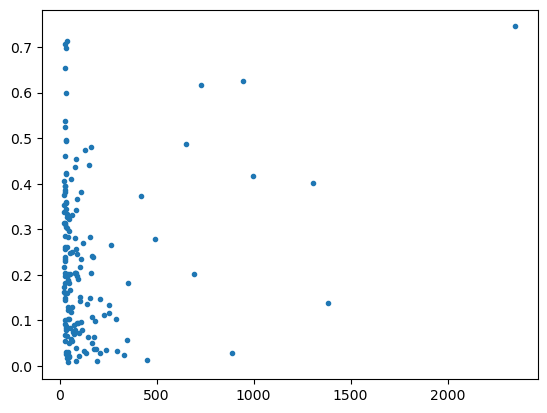

In [18]:
plt.plot(area, ellipticity,'.')

In [66]:
print(np.max(segment_map))
print(np.max(label))
print(np.sum([area<1000]))

159
159
156


In [67]:
#ecc = (ellipticity < 0.5) | (area < 500)
ecc = (area < 1000)
roundsources = label[ecc]
print(np.sum(roundsources))

12605


In [68]:
import numpy as np
from roman_datamodels.dqflags import pixel

datamasked = data0.copy()
mask = np.isin(segment_map, roundsources)
datamasked[mask] = np.nan

mask = (dq & pixel.DO_NOT_USE.value) | (dq & pixel.DEAD) | (dq & pixel.SATURATED)| (dq & pixel.JUMP_DET) 
datamasked[mask == 1] = np.nan

In [69]:
from maskfill import maskfill
idx = datamasked == np.nan
mask = np.zeros(np.shape(datamasked))
mask[idx] = 1
datafilled,_ = maskfill(datamasked, mask)

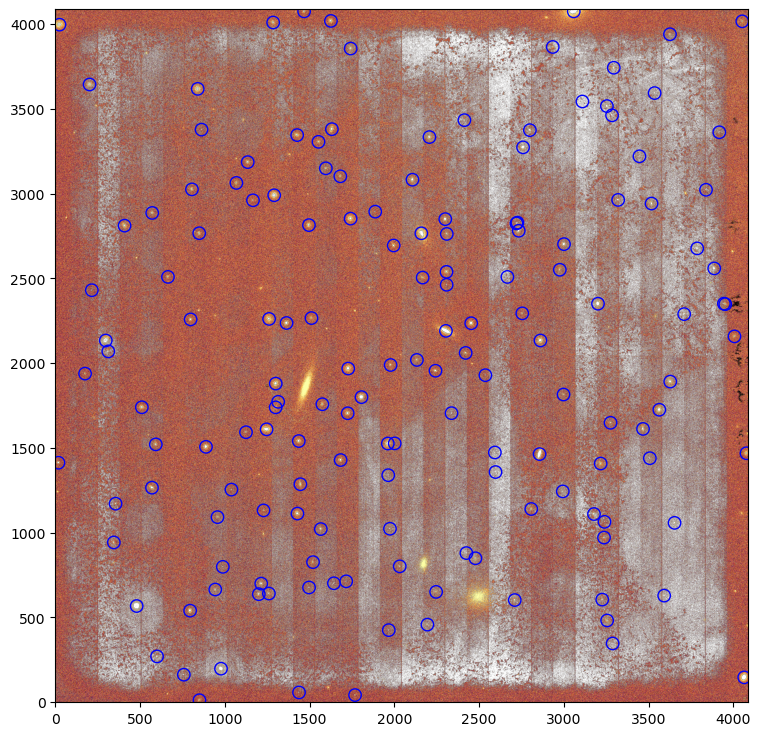

In [73]:
import matplotlib.pyplot as plt
from astropy import visualization
norm = visualization.ImageNormalize(datamasked,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(datamasked, norm=norm, origin='lower',cmap='inferno')
plt.scatter(x[ecc],y[ecc],facecolors='none',edgecolor='blue',s=80)

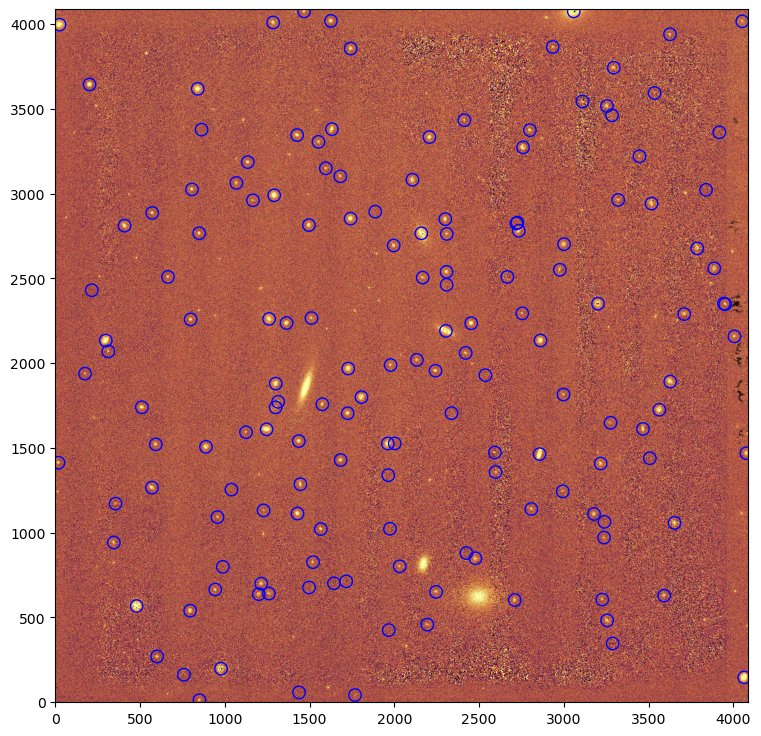

In [75]:
fig, ax = plt.subplots(figsize=(9, 9))
plot = ax.imshow(datafilled, norm=norm, origin='lower',cmap='inferno')
plt.scatter(x[ecc],y[ecc],facecolors='none',edgecolor='blue',s=80)

In [28]:
from astropy.nddata import block_reduce
nblock = 7*2
data1 = block_reduce(datafilled, nblock, func=np.nanmedian)

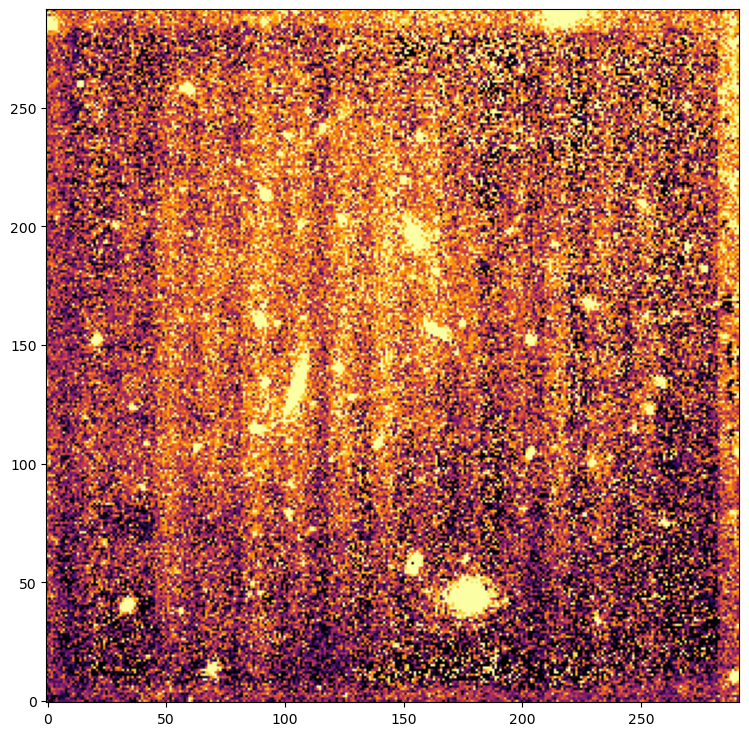

In [29]:
fig, ax = plt.subplots(figsize=(9, 9))
norm = visualization.ImageNormalize(data1,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
plot = ax.imshow(data1, norm=norm, origin='lower',cmap='inferno')

In [78]:
from astropy.nddata import block_reduce
nblock = 7*2
data2 = block_reduce(datamasked, nblock, func=np.nanmedian)

/Users/dfadda/miniconda3/envs/wfiskymatch/lib/python3.13/site-packages/astropy/nddata/blocks.py:160: RuntimeWarning: All-NaN slice encountered
  return func(reshaped, axis=axis)


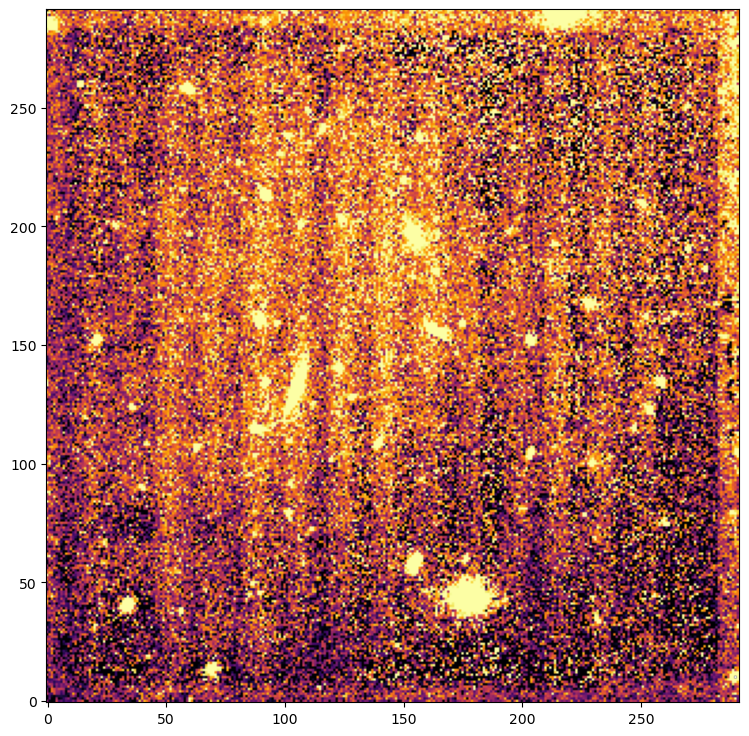

In [79]:
fig, ax = plt.subplots(figsize=(9, 9))
norm = visualization.ImageNormalize(data2,
                                    interval=visualization.ZScaleInterval(contrast=1),
                                    stretch=visualization.AsinhStretch(a=1))
plot = ax.imshow(data2, norm=norm, origin='lower',cmap='inferno')

In [37]:
?maskfill

Signature:
maskfill(
    input_image: Union[str, numpy.ndarray],
    mask: Union[str, numpy.ndarray],
    ext: int = 0,
    size: int = 3,
    operator: str = 'median',
    smooth: bool = True,
    writesteps: bool = False,
    output_file: str = None,
    verbose: bool = False,
)
Docstring:
Maskfill function used to smoothly iteratively fill masks in images. 
See van Dokkum et al. 2023 (PASP) for details.

Parameters
----------
input_image : Union[str,np.ndarray]
    input image; either a path to a `.fits` file or a numpy ndarray
mask : Union[str,np.ndarray]
    mask image; either a path to a `.fits` file or a numpy ndarray [0 = good, 1 = bad/fill location]
    Note that any NaN values in the mask file will be ignored (i.e., treated as 0). 
ext : int, optional
    fits extension in input and mask where data are stored, by default 0
size : int, optional
    size for the filter to use (must be odd) --- a size of three implies the 8 pixels surrounding 1 pixel are considered, by default 3

In [207]:
3.1/0.11

28.181818181818183